In [2]:
#STEP 1: Load the Data.
import pandas as pd

# Load the dataset
file_path = '/Users/deveshattri/Desktop/SkillCraft Technology Internship/API_SP/API_SP.POP.TOTL_DS2_en_csv_v2_539898.csv'
data = pd.read_csv(file_path, skiprows=4)  # Skip the first 4 rows which usually contain metadata

# Display the first few rows of the dataset
data.head()

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2015,2016,2017,2018,2019,2020,2021,2022,2023,Unnamed: 68
0,Aruba,ABW,"Population, total",SP.POP.TOTL,54608.0,55811.0,56682.0,57475.0,58178.0,58782.0,...,104257.0,104874.0,105439.0,105962.0,106442.0,106585.0,106537.0,106445.0,106277.0,NaN
1,Africa Eastern and Southern,AFE,"Population, total",SP.POP.TOTL,130692579.0,134169237.0,137835590.0,141630546.0,145605995.0,149742351.0,...,600008424.0,616377605.0,632746570.0,649757148.0,667242986.0,685112979.0,702977106.0,720859132.0,739108306.0,NaN
2,Afghanistan,AFG,"Population, total",SP.POP.TOTL,8622466.0,8790140.0,8969047.0,9157465.0,9355514.0,9565147.0,...,33753499.0,34636207.0,35643418.0,36686784.0,37769499.0,38972230.0,40099462.0,41128771.0,42239854.0,NaN
3,Africa Western and Central,AFW,"Population, total",SP.POP.TOTL,97256290.0,99314028.0,101445032.0,103667517.0,105959979.0,108336203.0,...,408690375.0,419778384.0,431138704.0,442646825.0,454306063.0,466189102.0,478185907.0,490330870.0,502789511.0,NaN
4,Angola,AGO,"Population, total",SP.POP.TOTL,5357195.0,5441333.0,5521400.0,5599827.0,5673199.0,5736582.0,...,28127721.0,29154746.0,30208628.0,31273533.0,32353588.0,33428486.0,34503774.0,35588987.0,36684202.0,NaN


In [3]:
#STEP 2: Inspect the data

# Display the summary of the dataset
print("\nSummary of the dataset:")
print(data.info())

# Check for missing values
print("\nMissing values in the dataset:")
print(data.isnull().sum())

# Display basic statistics of the dataset
print("\nBasic statistics of the dataset:")
print(data.describe(include='all'))


Summary of the dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 69 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Country Name    266 non-null    object 
 1   Country Code    266 non-null    object 
 2   Indicator Name  266 non-null    object 
 3   Indicator Code  266 non-null    object 
 4   1960            264 non-null    float64
 5   1961            264 non-null    float64
 6   1962            264 non-null    float64
 7   1963            264 non-null    float64
 8   1964            264 non-null    float64
 9   1965            264 non-null    float64
 10  1966            264 non-null    float64
 11  1967            264 non-null    float64
 12  1968            264 non-null    float64
 13  1969            264 non-null    float64
 14  1970            264 non-null    float64
 15  1971            264 non-null    float64
 16  1972            264 non-null    float64
 17  1973      

In [4]:
#Step 3: Clean the data

# 1. Remove the 'Unnamed: 68' column.
data = data.drop(columns=['Unnamed: 68'], errors='ignore')

# 2. Handle Missing Values

# Fill missing population values with the mean value for each year
years = [col for col in data.columns if col.isdigit()]
data[years] = data[years].apply(lambda x: x.fillna(x.mean()), axis=0)

# 3. Remove duplicates
data = data.drop_duplicates()

# 4. Standardize Data Types
# Convert year columns to integers
data[years] = data[years].astype(int)

# Verify the changes
print("Cleaned Data Summary:")
print(data.info())
print("\nMissing values after cleaning:")
print(data.isnull().sum())

# Save the cleaned data to a new CSV file
cleaned_file_path = 'cleaned_dataset.csv'
data.to_csv(cleaned_file_path, index=False)
print(f"Cleaned data saved to {cleaned_file_path}")


data = pd.read_csv('cleaned_dataset.csv')


Cleaned Data Summary:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 68 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Country Name    266 non-null    object
 1   Country Code    266 non-null    object
 2   Indicator Name  266 non-null    object
 3   Indicator Code  266 non-null    object
 4   1960            266 non-null    int64 
 5   1961            266 non-null    int64 
 6   1962            266 non-null    int64 
 7   1963            266 non-null    int64 
 8   1964            266 non-null    int64 
 9   1965            266 non-null    int64 
 10  1966            266 non-null    int64 
 11  1967            266 non-null    int64 
 12  1968            266 non-null    int64 
 13  1969            266 non-null    int64 
 14  1970            266 non-null    int64 
 15  1971            266 non-null    int64 
 16  1972            266 non-null    int64 
 17  1973            266 non-null    

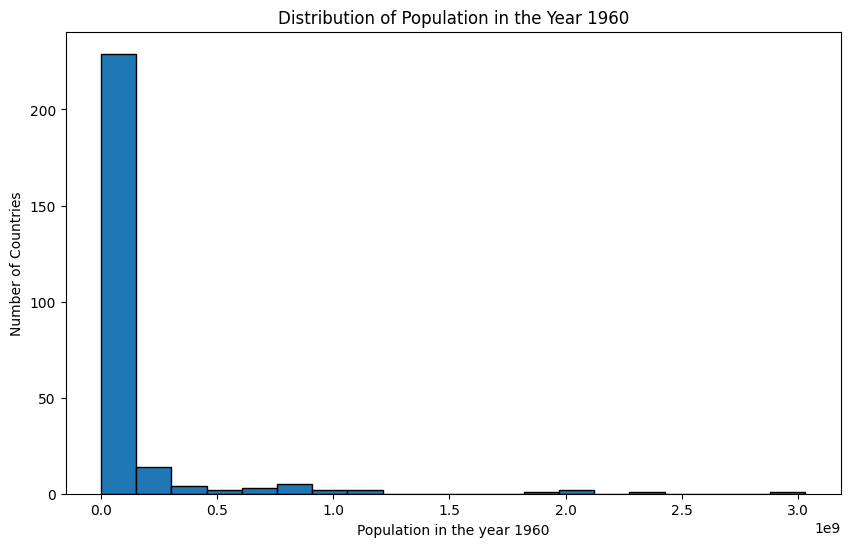

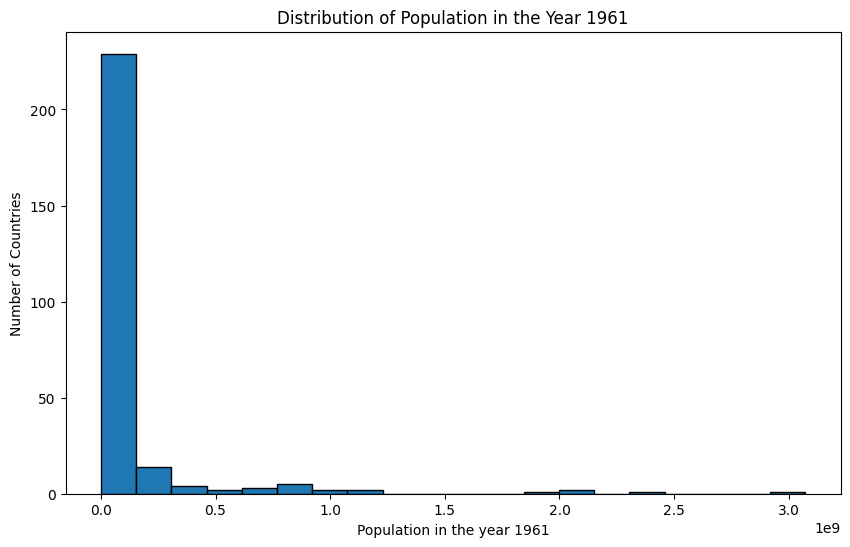

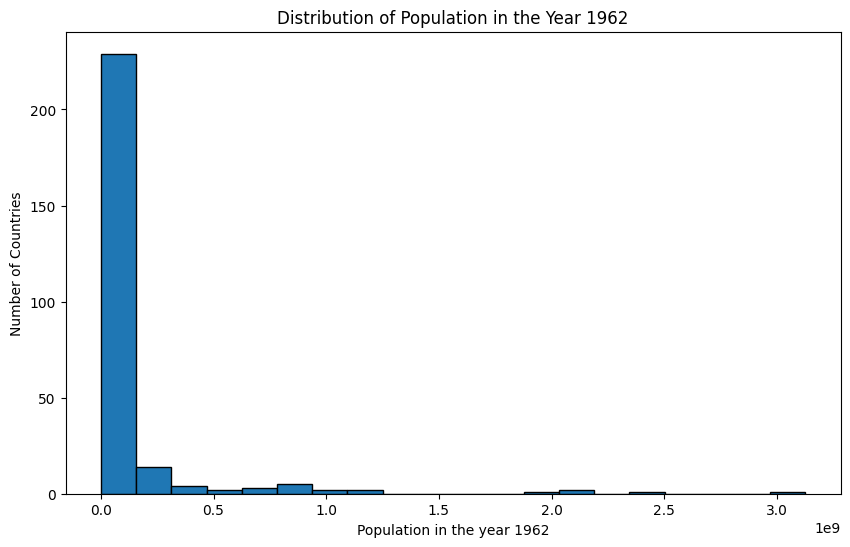

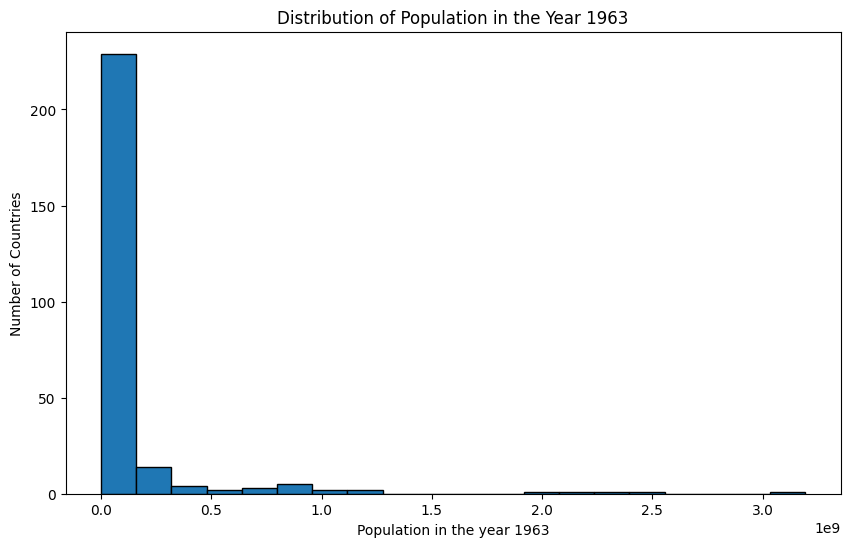

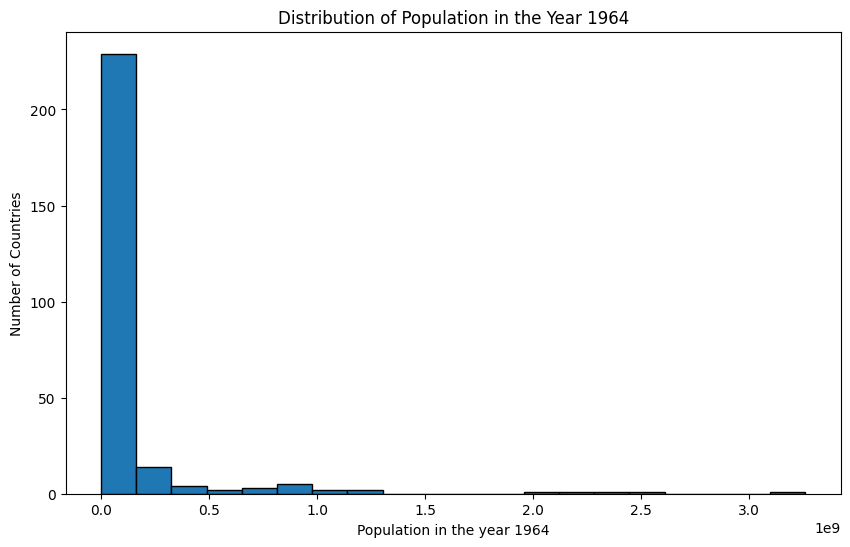

...

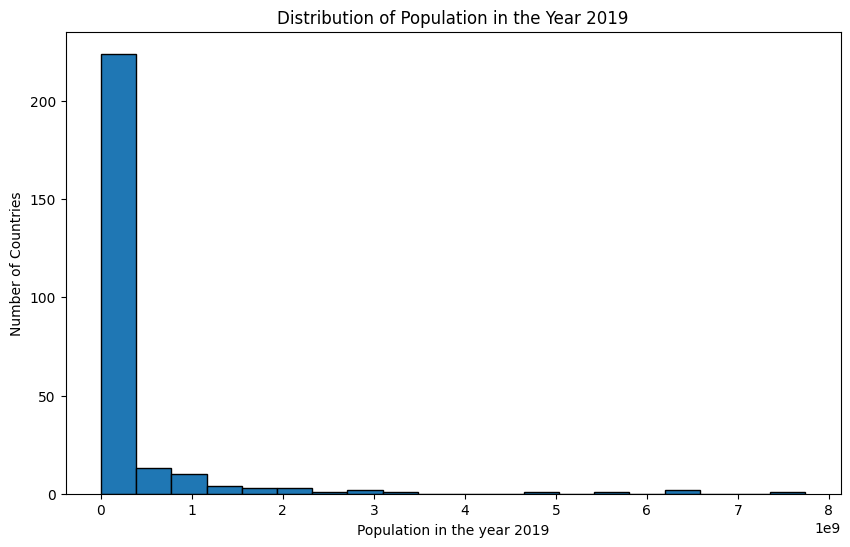

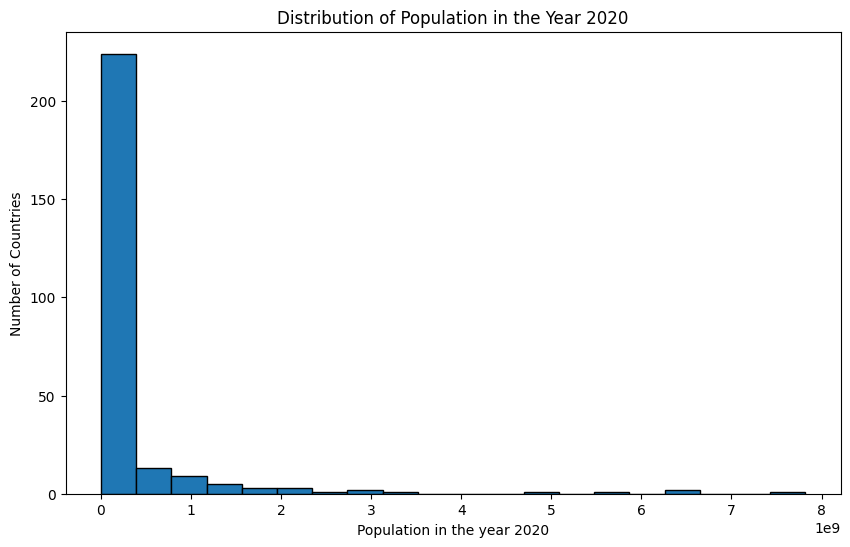

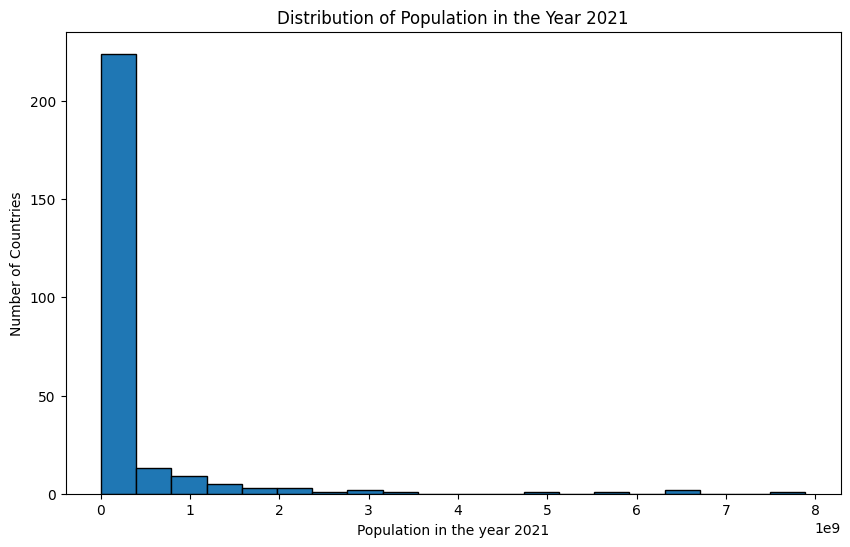

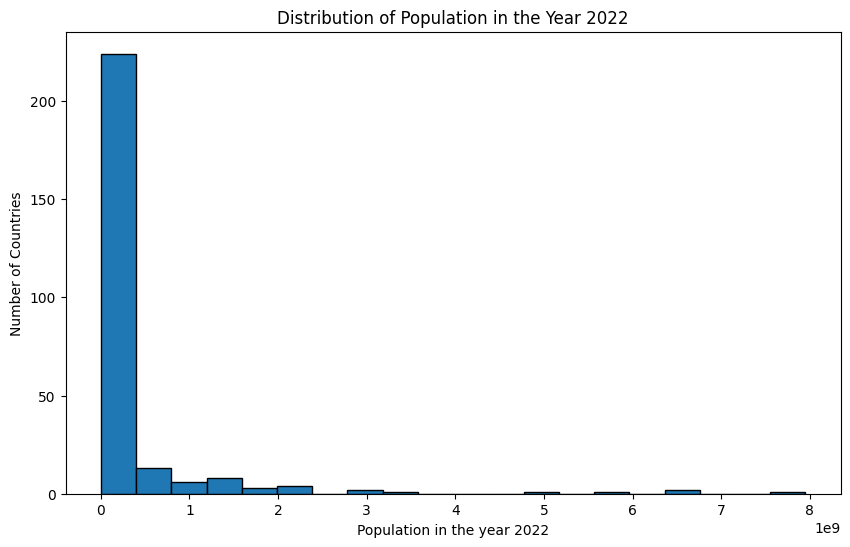

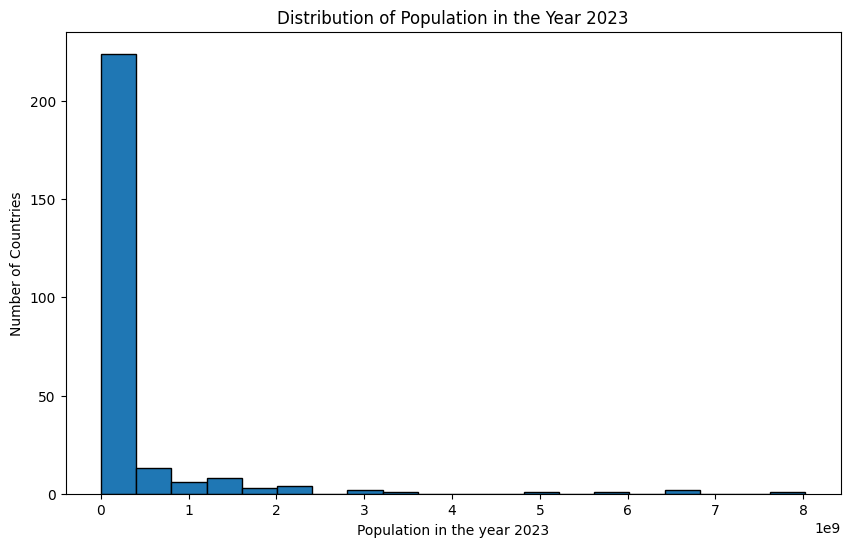

In [5]:
#Step 4: Let's take 2 variables:
#(i) X-Axis = Country Name
#(ii) Y-Axis = Country Population

#Let's create the histogram for every year.
import matplotlib.pyplot as plt

for i in years:
    population = data[['Country Name', i]]
    plt.figure(figsize=(10,6))
    plt.hist(population[i], bins=20, edgecolor='black')
    plt.xlabel(f'Population in the year {i}')
    plt.ylabel('Number of Countries')
    plt.title('Distribution of Population in the Year '+ i)
    plt.show()

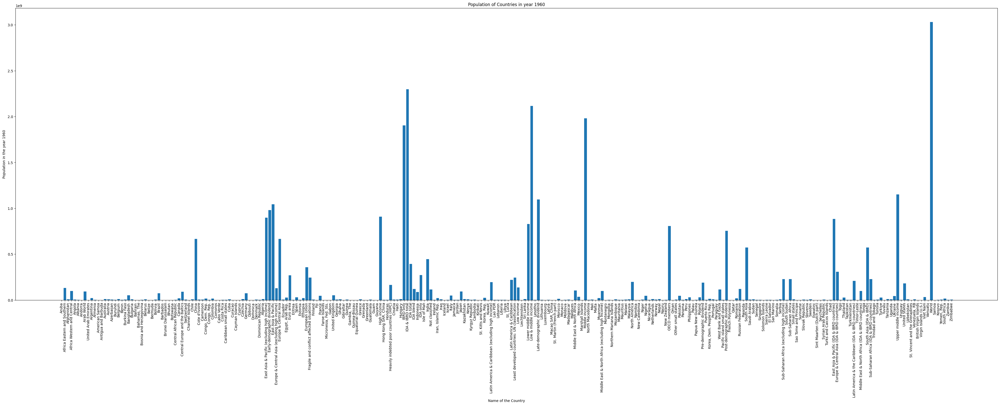

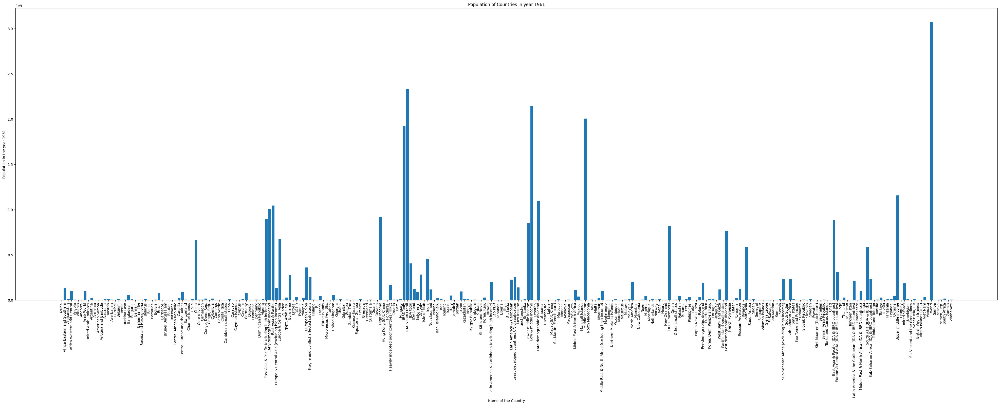

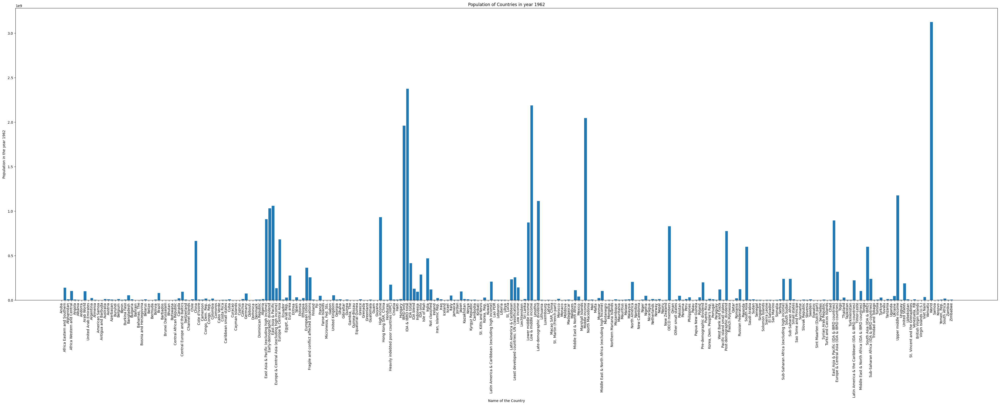

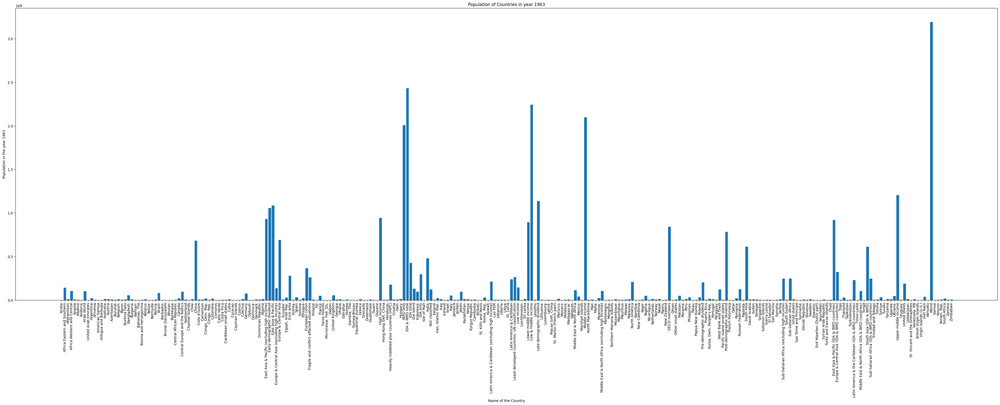

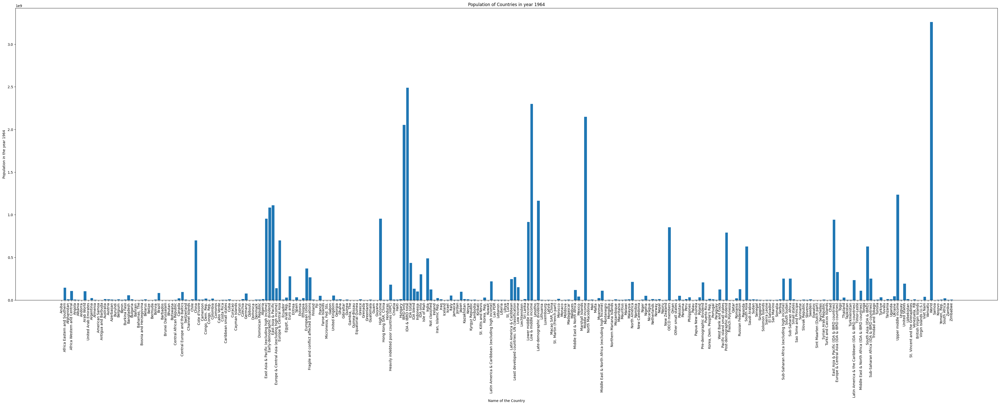

...

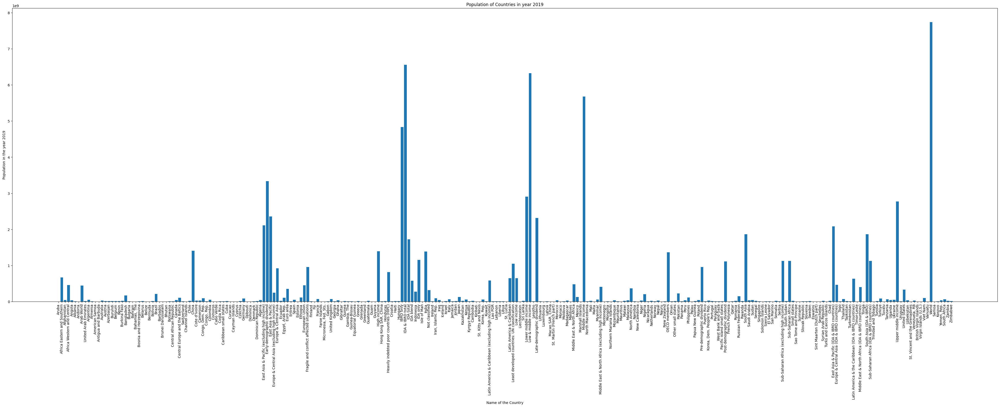

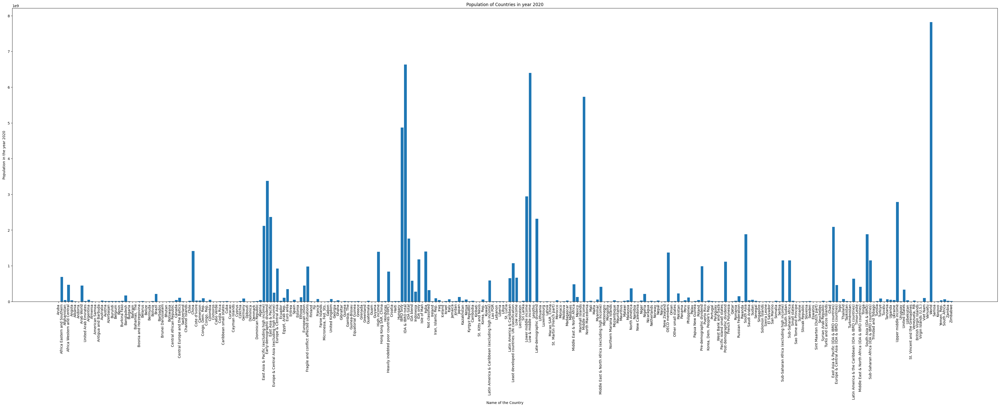

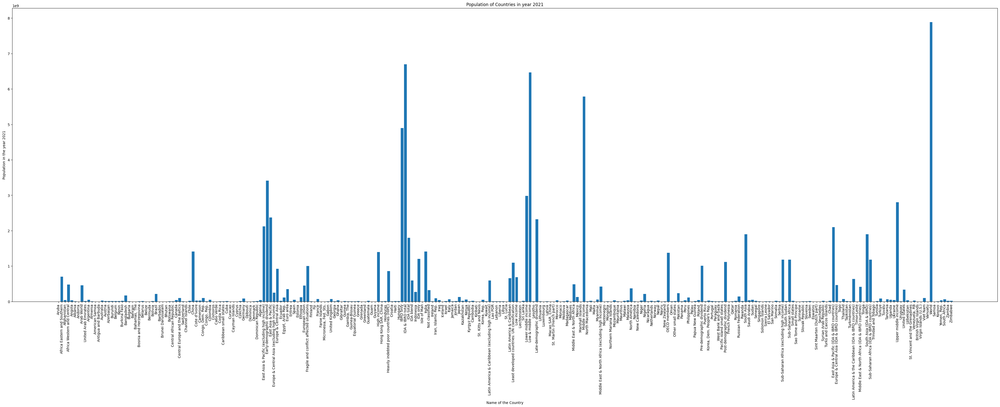

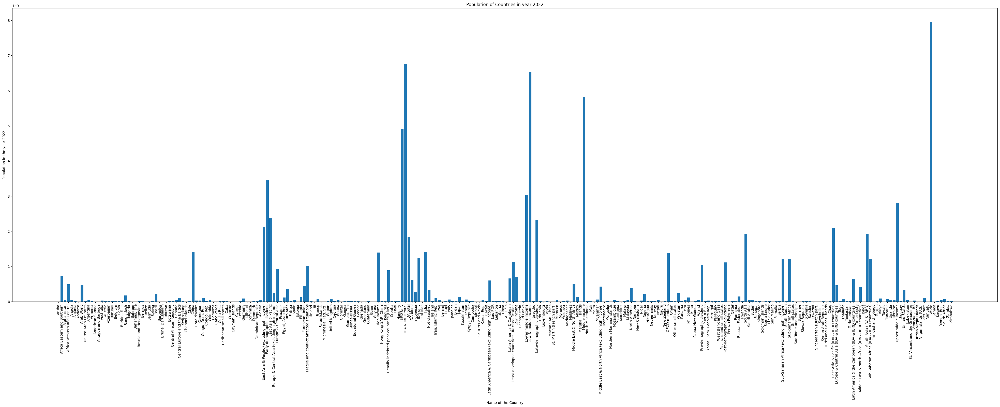

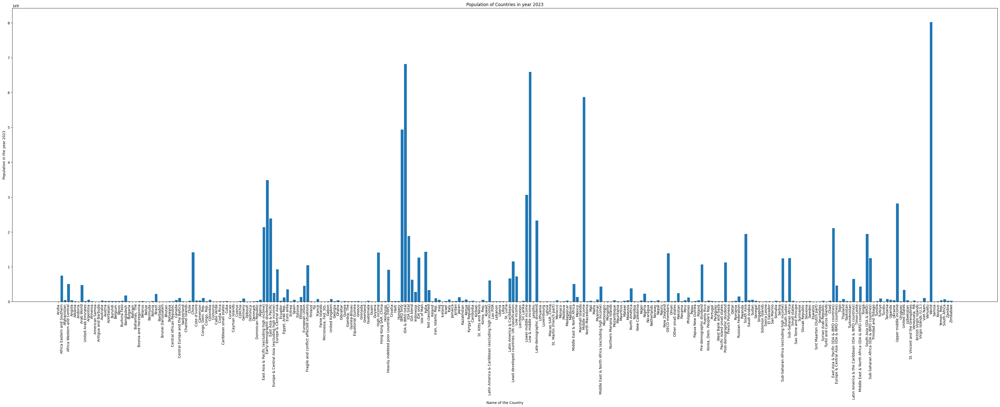

In [6]:
#Step 5: Now similarly let's make the bar chart

for i in years:
    population_bar= data[['Country Name', i]]
    plt.figure(figsize=(50,15))
    plt.bar(population_bar['Country Name'], population_bar[i])
    plt.xlabel('Name of the Country')
    plt.ylabel(f'Population in the year {i}')
    plt.title(f'Population of Countries in year {i}')
    plt.xticks(rotation=90)
    plt.show()